##### ***Note: Folium plots may not render properly within a jupyter notebook. To fix this, kindly run all the code cells in this notebook***

In [ ]:
import json
import requests
import ast

import pandas as pd
import numpy as np

%matplotlib inline

Importing the merged dataset csv into a dataframe

In [ ]:
df = pd.read_csv('./Both dataset merged.csv')

df.head(10)

,Unnamed: 0,Unnamed: 0_x,Yelp_Name,Yelp_Address,InspName,InspAddress,id,alias,name,image_url,...,State,Zip,Inspection Date,Inspection Type,Results,Violations,Latitude,Longitude,Location,Year
0,0,0,Ipsento,2035 N Western Ave,IPSENTO,2035 N WESTERN AVE,CZAVqR6lI50rVbN7E78aHA,ipsento-chicago,Ipsento,https://s3-media2.fl.yelpcdn.com/bphoto/6X1JnK...,...,IL,60647.0,07/21/2021,Canvass,Out of Business,NaN,41.918575,-87.687296,"(-87.68729592769105, 41.918574636596254)",2021
1,1,1,7-Eleven,600 N Mcclurg Ct,7- ELEVEN,600 N MCCLURG CT,FDA_nR9v0fyBqtJ92JE-7A,7-eleven-chicago-63,7-Eleven,https://s3-media1.fl.yelpcdn.com/bphoto/Gs4zYJ...,...,IL,60611.0,06/18/2021,Canvass,Pass,NaN,41.892679,-87.617864,"(-87.61786371164598, 41.89267922007347)",2021
2,2,2,Chicago by Night,5600 W Belmont Ave,CHICAGO BY NIGHT,5600 W BELMONT AVE,sp10QI-XDe404UTtNRAj8A,chicago-by-night-chicago,Chicago by Night,https://s3-media3.fl.yelpcdn.com/bphoto/3p90we...,...,IL,60634.0,04/16/2021,Non-Inspection,No Entry,NaN,41.938684,-87.766562,"(-87.76656249384537, 41.93868377475747)",2021
3,3,3,Grace's African Restaurant,4409 N Broadway St,GRACE AFRICAN RESTAURANT,4409 N BROADWAY,h5WZDw4Ctm90e_UgebEpAw,graces-african-restaurant-chicago,Grace's African Restaurant,https://s3-media1.fl.yelpcdn.com/bphoto/ktvnG9...,...,IL,60640.0,02/06/2020,Canvass,Out of Business,NaN,41.962104,-87.655204,"(-87.65520382960334, 41.96210413223745)",2020
4,5,4,Furious Spoon Pilsen,1316 W 18th St,FURIOUS SPOON,1316 W 18TH ST,xtO4wPqXmmJ4w0YF792AcQ,furious-spoon-pilsen-chicago,Furious Spoon Pilsen,https://s3-media3.fl.yelpcdn.com/bphoto/T2CJQg...,...,IL,60608.0,04/05/2021,Canvass,Out of Business,NaN,41.858011,-87.659722,"(-87.65972203307506, 41.85801089049448)",2021
5,6,5,En Passant,3010 W Diversey Ave,EN PASSANT,3010 W DIVERSEY AVE,-PZG1swO6O7biElGLnCxlQ,en-passant-chicago,En Passant,https://s3-media2.fl.yelpcdn.com/bphoto/OFdxRr...,...,IL,60647.0,04/01/2021,License,Fail,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...",41.932165,-87.703009,"(-87.70300922160574, 41.932164868426376)",2021
6,7,6,Beaubien Elem Jean Baptiste,5025 N Laramie Ave,Beaubien Elementary School,5025 N Laramie (5200W),WQjgr9fwZdt_vwQso9wJ4g,beaubien-elem-jean-baptiste-chicago,Beaubien Elem Jean Baptiste,https://s3-media1.fl.yelpcdn.com/bphoto/P-4Qaq...,...,IL,60630.0,04/05/2021,Canvass,Pass,NaN,41.972379,-87.757528,"(-87.75752776008068, 41.972379135874)",2021
7,8,7,Uncommon Ground,3800 N Clark St,UNCOMMON GROUND,3800 N CLARK ST,zcMR0uDgshgPA0rauDlekA,uncommon-ground-chicago,Uncommon Ground,https://s3-media3.fl.yelpcdn.com/bphoto/wv5P9h...,...,IL,60613.0,08/15/2013,Canvass,Out of Business,NaN,41.951064,-87.659795,"(-87.65979512802838, 41.951064053085005)",2013
8,10,8,The Drake,140 E Walton Pl,THE DRAKE HOTEL,140 E WALTON PL,31yYZQjEIyYE0N3p_vmoOA,the-drake-chicago-2,The Drake,https://s3-media1.fl.yelpcdn.com/bphoto/fGGCdZ...,...,IL,60611.0,04/15/2021,License Re-Inspection,Pass,NaN,41.900118,-87.623981,"(-87.62398051946951, 41.90011845725853)",2021
9,11,5710,Millennium Knickerbocker Hotel - Chicago,163 E Walton Pl,THE DRAKE HOTEL,140 E WALTON PL,sGhw4H2gzW0psZom0QuZMw,millennium-knickerbocker-hotel-chicago-chicago-2,Millennium Knickerbocker Hotel - Chicago,https://s3-media3.fl.yelpcdn.com/bphoto/KpWV2_...,...,IL,60611.0,04/15/2021,License Re-Inspection,Pass,NaN,41.900118,-87.623981,"(-87.62398051946951, 41.90011845725853)",2021


In [ ]:
df.shape

(15266, 46)

In [ ]:
df.columns

Index(['Unnamed: 0', 'Unnamed: 0_x', 'Yelp_Name', 'Yelp_Address', 'InspName',
       'InspAddress', 'id', 'alias', 'name', 'image_url', 'is_claimed',
       'is_closed', 'url', 'phone', 'display_phone', 'review_count',
       'categories', 'rating', 'location', 'coordinates', 'photos', 'price',
       'hours', 'transactions', 'messaging', 'special_hours', 'NameAddString',
       'Unnamed: 0_y', 'Inspection ID', 'DBA Name', 'AKA Name', 'License #',
       'Facility Type', 'Risk', 'Address', 'City', 'State', 'Zip',
       'Inspection Date', 'Inspection Type', 'Results', 'Violations',
       'Latitude', 'Longitude', 'Location', 'Year'],
      dtype='object')

Dropping unnnecessary columns

In [ ]:
df.drop(['Unnamed: 0', 'Unnamed: 0_x', 'InspName', 'image_url', 'InspAddress', 'id', 'alias', 'name', 'NameAddString', 'Unnamed: 0_y',
         'phone', 'DBA Name', 'AKA Name', 'Address', 'location', 'City', 'State','Latitude','Longitude'], axis = 1, inplace = True)

df.columns

Index(['Yelp_Name', 'Yelp_Address', 'is_claimed', 'is_closed', 'url',
       'display_phone', 'review_count', 'categories', 'rating', 'coordinates',
       'photos', 'price', 'hours', 'transactions', 'messaging',
       'special_hours', 'Inspection ID', 'License #', 'Facility Type', 'Risk',
       'Zip', 'Inspection Date', 'Inspection Type', 'Results', 'Violations',
       'Location', 'Year'],
      dtype='object')

Renaming the columns

In [ ]:
df.rename(columns = {'Yelp_Name': 'Name', 'Yelp_Address': 'Address'}, inplace = True)

df.columns

Index(['Name', 'Address', 'is_claimed', 'is_closed', 'url', 'display_phone',
       'review_count', 'categories', 'rating', 'coordinates', 'photos',
       'price', 'hours', 'transactions', 'messaging', 'special_hours',
       'Inspection ID', 'License #', 'Facility Type', 'Risk', 'Zip',
       'Inspection Date', 'Inspection Type', 'Results', 'Violations',
       'Location', 'Year'],
      dtype='object')

In [ ]:
df

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,rating,coordinates,...,License #,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year
0,Ipsento,2035 N Western Ave,True,True,https://www.yelp.com/biz/ipsento-chicago?adjus...,(773) 904-8177,840,"[{'alias': 'coffee', 'title': 'Coffee & Tea'},...",4.5,"{'latitude': 41.9186515808105, 'longitude': -8...",...,1741994.0,Restaurant,Risk 2 (Medium),60647.0,07/21/2021,Canvass,Out of Business,NaN,"(-87.68729592769105, 41.918574636596254)",2021
1,7-Eleven,600 N Mcclurg Ct,True,False,https://www.yelp.com/biz/7-eleven-chicago-63?a...,(312) 649-9671,34,"[{'alias': 'convenience', 'title': 'Convenienc...",4.0,"{'latitude': 41.8930400289638, 'longitude': -8...",...,1738996.0,Grocery Store,Risk 2 (Medium),60611.0,06/18/2021,Canvass,Pass,NaN,"(-87.61786371164598, 41.89267922007347)",2021
2,Chicago by Night,5600 W Belmont Ave,True,False,https://www.yelp.com/biz/chicago-by-night-chic...,(773) 794-0300,24,"[{'alias': 'danceclubs', 'title': 'Dance Clubs...",3.5,"{'latitude': 41.9386719, 'longitude': -87.7667...",...,1170649.0,Restaurant,Risk 1 (High),60634.0,04/16/2021,Non-Inspection,No Entry,NaN,"(-87.76656249384537, 41.93868377475747)",2021
3,Grace's African Restaurant,4409 N Broadway St,False,False,https://www.yelp.com/biz/graces-african-restau...,(773) 271-6000,25,"[{'alias': 'african', 'title': 'African'}]",3.0,"{'latitude': 41.96223, 'longitude': -87.65518}",...,1620462.0,Restaurant,Risk 1 (High),60640.0,02/06/2020,Canvass,Out of Business,NaN,"(-87.65520382960334, 41.96210413223745)",2020
4,Furious Spoon Pilsen,1316 W 18th St,True,True,https://www.yelp.com/biz/furious-spoon-pilsen-...,(312) 624-8461,233,"[{'alias': 'ramen', 'title': 'Ramen'}]",3.5,"{'latitude': 41.8581657277855, 'longitude': -8...",...,2483679.0,Restaurant,Risk 1 (High),60608.0,04/05/2021,Canvass,Out of Business,NaN,"(-87.65972203307506, 41.85801089049448)",2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15261,Arby's,195 N Dearborn St,False,True,https://www.yelp.com/biz/arbys-chicago-5?adjus...,(312) 263-3515,11,"[{'alias': 'hotdogs', 'title': 'Fast Food'}]",3.0,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,25193.0,NaN,Risk 1 (High),60601.0,01/14/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010
15262,Burrito Beach,195 N Dearborn St,True,True,https://www.yelp.com/biz/burrito-beach-chicago...,(312) 372-6272,15,"[{'alias': 'restaurants', 'title': 'Restaurant...",3.5,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,25195.0,NaN,Risk 1 (High),60601.0,01/15/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010
15263,Greenleaf Food Market,1619 S Michigan Ave,True,False,https://www.yelp.com/biz/greenleaf-food-market...,(312) 753-3140,4,"[{'alias': 'grocery', 'title': 'Grocery'}]",2.5,"{'latitude': 41.8597559, 'longitude': -87.6237...",...,1964371.0,Grocery Store,Risk 1 (High),60616.0,01/12/2010,Complaint,Pass w/ Conditions,"1. SOURCE SOUND CONDITION, NO SPOILAGE, FOODS ...","(-87.62382786533588, 41.859697626140715)",2010
15264,Kenny's Ribs & Chicken,1461 E Hyde Park Blvd,False,True,https://www.yelp.com/biz/kennys-ribs-and-chick...,(773) 241-5550,2,"[{'alias': 'newamerican', 'title': 'American (...",3.5,"{'latitude': 41.8023151, 'longitude': -87.5901...",...,81030.0,Restaurant,Risk 1 (High),60615.0,02/08/2010,Complaint,Pass,"30. FOOD IN ORIGINAL CONTAINER, PROPERLY LABEL...","(-87.58967573279067, 41.80233814333551)",2010


### Converting column data types

In [ ]:
df.dtypes

Name                object
Address             object
is_claimed            bool
is_closed             bool
url                 object
display_phone       object
review_count         int64
categories          object
rating             float64
coordinates         object
photos              object
price               object
hours               object
transactions        object
messaging           object
special_hours       object
Inspection ID        int64
License #          float64
Facility Type       object
Risk                object
Zip                float64
Inspection Date     object
Inspection Type     object
Results             object
Violations          object
Location            object
Year                 int64
dtype: object

In [ ]:
df['categories'] = df['categories'].fillna('[]')
df['hours'] = df['hours'].fillna('[]')
df['special_hours'] = df['special_hours'].fillna('[]')
df['transactions'] = df['transactions'].fillna('[]')

Checking if any NAN cells present in the columns

In [ ]:
print(df['categories'].isna().sum())
print(df['hours'].isna().sum())
print(df['special_hours'].isna().sum())
print(df['transactions'].isna().sum())

0
0
0
0


Converting object datatypes of columns to list

In [ ]:
df['categories'] = df['categories'].apply(ast.literal_eval)
df['hours'] = df['hours'].apply(ast.literal_eval)
df['special_hours'] = df['special_hours'].apply(ast.literal_eval)
df['transactions'] = df['transactions'].apply(ast.literal_eval)

Checking whether the datatype of columns converted into list or not

In [ ]:
print(type(list(df['categories'])[0]))
print(type(list(df['hours'])[0]))
print(type(list(df['special_hours'])[0]))
print(type(list(df['transactions'])[0]))

<class 'list'>
<class 'list'>
<class 'list'>
<class 'list'>


In [ ]:
df.columns

Index(['Name', 'Address', 'is_claimed', 'is_closed', 'url', 'display_phone',
       'review_count', 'categories', 'rating', 'coordinates', 'photos',
       'price', 'hours', 'transactions', 'messaging', 'special_hours',
       'Inspection ID', 'License #', 'Facility Type', 'Risk', 'Zip',
       'Inspection Date', 'Inspection Type', 'Results', 'Violations',
       'Location', 'Year'],
      dtype='object')

# EDA Analysis 

Rating v/s Review Count

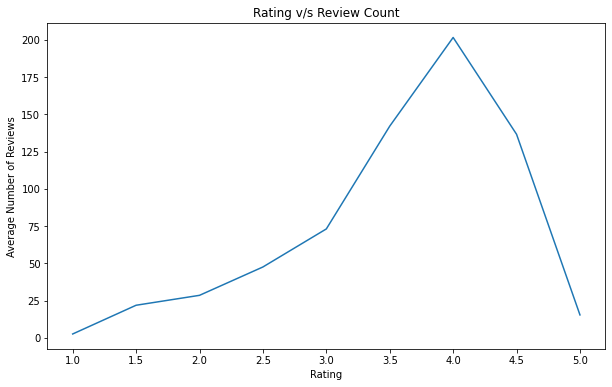

In [ ]:
ax = df[["rating", "review_count"]].groupby("rating").mean().sort_values("rating").plot(title = 'Rating v/s Review Count',
                        xlabel = 'Rating', ylabel = 'Average Number of Reviews', legend = False, figsize = (10, 6))

Rating v/s Number of Food Facilities

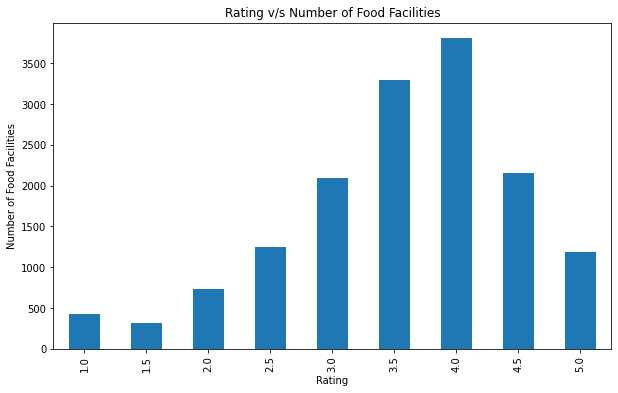

In [ ]:
ax = df[["rating", "Name"]].groupby("rating").count().sort_values("rating").plot(title = 'Rating v/s Number of Food Facilities',
                        xlabel = 'Rating', ylabel = 'Number of Food Facilities', legend = False, kind = 'bar', figsize = (10, 6))

Transaction Methods v/s Number of Food Facilities

In [ ]:
df["transactions_count"] = df.transactions.map(len)
df

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,rating,coordinates,...,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year,transactions_count
0,Ipsento,2035 N Western Ave,True,True,https://www.yelp.com/biz/ipsento-chicago?adjus...,(773) 904-8177,840,"[{'alias': 'coffee', 'title': 'Coffee & Tea'},...",4.5,"{'latitude': 41.9186515808105, 'longitude': -8...",...,Restaurant,Risk 2 (Medium),60647.0,07/21/2021,Canvass,Out of Business,NaN,"(-87.68729592769105, 41.918574636596254)",2021,1
1,7-Eleven,600 N Mcclurg Ct,True,False,https://www.yelp.com/biz/7-eleven-chicago-63?a...,(312) 649-9671,34,"[{'alias': 'convenience', 'title': 'Convenienc...",4.0,"{'latitude': 41.8930400289638, 'longitude': -8...",...,Grocery Store,Risk 2 (Medium),60611.0,06/18/2021,Canvass,Pass,NaN,"(-87.61786371164598, 41.89267922007347)",2021,0
2,Chicago by Night,5600 W Belmont Ave,True,False,https://www.yelp.com/biz/chicago-by-night-chic...,(773) 794-0300,24,"[{'alias': 'danceclubs', 'title': 'Dance Clubs...",3.5,"{'latitude': 41.9386719, 'longitude': -87.7667...",...,Restaurant,Risk 1 (High),60634.0,04/16/2021,Non-Inspection,No Entry,NaN,"(-87.76656249384537, 41.93868377475747)",2021,1
3,Grace's African Restaurant,4409 N Broadway St,False,False,https://www.yelp.com/biz/graces-african-restau...,(773) 271-6000,25,"[{'alias': 'african', 'title': 'African'}]",3.0,"{'latitude': 41.96223, 'longitude': -87.65518}",...,Restaurant,Risk 1 (High),60640.0,02/06/2020,Canvass,Out of Business,NaN,"(-87.65520382960334, 41.96210413223745)",2020,1
4,Furious Spoon Pilsen,1316 W 18th St,True,True,https://www.yelp.com/biz/furious-spoon-pilsen-...,(312) 624-8461,233,"[{'alias': 'ramen', 'title': 'Ramen'}]",3.5,"{'latitude': 41.8581657277855, 'longitude': -8...",...,Restaurant,Risk 1 (High),60608.0,04/05/2021,Canvass,Out of Business,NaN,"(-87.65972203307506, 41.85801089049448)",2021,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15261,Arby's,195 N Dearborn St,False,True,https://www.yelp.com/biz/arbys-chicago-5?adjus...,(312) 263-3515,11,"[{'alias': 'hotdogs', 'title': 'Fast Food'}]",3.0,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,NaN,Risk 1 (High),60601.0,01/14/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010,0
15262,Burrito Beach,195 N Dearborn St,True,True,https://www.yelp.com/biz/burrito-beach-chicago...,(312) 372-6272,15,"[{'alias': 'restaurants', 'title': 'Restaurant...",3.5,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,NaN,Risk 1 (High),60601.0,01/15/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010,0
15263,Greenleaf Food Market,1619 S Michigan Ave,True,False,https://www.yelp.com/biz/greenleaf-food-market...,(312) 753-3140,4,"[{'alias': 'grocery', 'title': 'Grocery'}]",2.5,"{'latitude': 41.8597559, 'longitude': -87.6237...",...,Grocery Store,Risk 1 (High),60616.0,01/12/2010,Complaint,Pass w/ Conditions,"1. SOURCE SOUND CONDITION, NO SPOILAGE, FOODS ...","(-87.62382786533588, 41.859697626140715)",2010,2
15264,Kenny's Ribs & Chicken,1461 E Hyde Park Blvd,False,True,https://www.yelp.com/biz/kennys-ribs-and-chick...,(773) 241-5550,2,"[{'alias': 'newamerican', 'title': 'American (...",3.5,"{'latitude': 41.8023151, 'longitude': -87.5901...",...,Restaurant,Risk 1 (High),60615.0,02/08/2010,Complaint,Pass,"30. FOOD IN ORIGINAL CONTAINER, PROPERLY LABEL...","(-87.58967573279067, 41.80233814333551)",2010,0


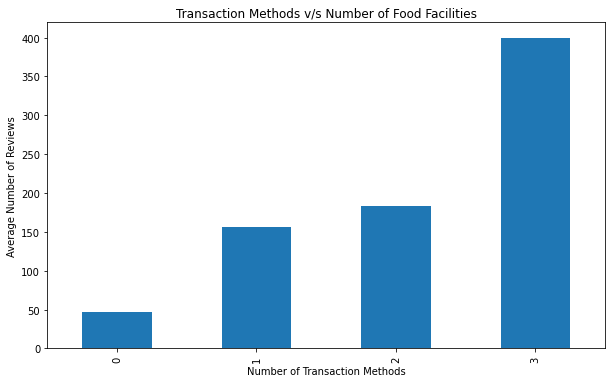

In [ ]:
ax = df[["transactions_count", "review_count"]].groupby("transactions_count").mean().sort_values("transactions_count")\
    .plot(title = 'Transaction Methods v/s Number of Food Facilities',
        xlabel = 'Number of Transaction Methods', ylabel = 'Average Number of Reviews', legend = False,
        kind = 'bar', figsize = (10, 6))

Transaction Methods v/s Rating

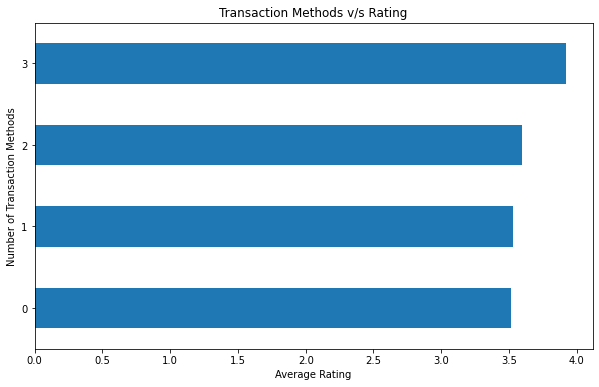

In [ ]:
ax = df[["transactions_count", "rating"]].groupby("transactions_count").mean().sort_values("transactions_count")\
    .plot(title = 'Transaction Methods v/s Rating',
        xlabel = 'Number of Transaction Methods', legend = False,
        kind = 'barh', figsize = (10, 6))

_ = ax.set_xlabel('Average Rating')

Risk v/s Average Rating

In [ ]:
df['price'] = df['price'].fillna('Unknown')
df['price'].replace({"$": 1, "$$": 2,'$$$': 3,'$$$$':4}, inplace=True)  

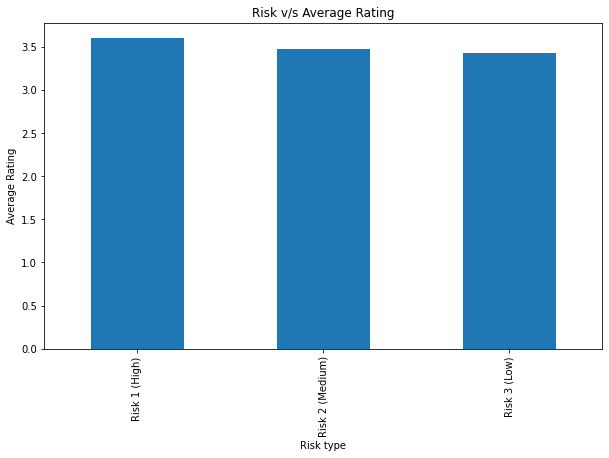

In [ ]:
ax = df[["Risk", "rating"]][df.Risk != 'All'].groupby("Risk").mean().sort_values("Risk")\
    .plot(title = 'Risk v/s Average Rating',
        xlabel = 'Risk type', ylabel = 'Average Rating', legend = False,
        kind = 'bar', figsize = (10, 6))

Business Status based on Rating

In [ ]:
# dataframe of closed restaurants
closed = df[df['is_closed'] == True]
closed

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,rating,coordinates,...,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year,transactions_count
0,Ipsento,2035 N Western Ave,True,True,https://www.yelp.com/biz/ipsento-chicago?adjus...,(773) 904-8177,840,"[{'alias': 'coffee', 'title': 'Coffee & Tea'},...",4.5,"{'latitude': 41.9186515808105, 'longitude': -8...",...,Restaurant,Risk 2 (Medium),60647.0,07/21/2021,Canvass,Out of Business,NaN,"(-87.68729592769105, 41.918574636596254)",2021,1
4,Furious Spoon Pilsen,1316 W 18th St,True,True,https://www.yelp.com/biz/furious-spoon-pilsen-...,(312) 624-8461,233,"[{'alias': 'ramen', 'title': 'Ramen'}]",3.5,"{'latitude': 41.8581657277855, 'longitude': -8...",...,Restaurant,Risk 1 (High),60608.0,04/05/2021,Canvass,Out of Business,NaN,"(-87.65972203307506, 41.85801089049448)",2021,2
11,Max's Take Out,20 E Adams St,True,True,https://www.yelp.com/biz/maxs-take-out-chicago...,(312) 553-0170,519,"[{'alias': 'tradamerican', 'title': 'American ...",4.0,"{'latitude': 41.87972, 'longitude': -87.62688}",...,Restaurant,Risk 1 (High),60603.0,03/04/2021,Canvass,Out of Business,NaN,"(-87.6269991129734, 41.87960812540506)",2021,2
15,Subway,236 S State St,True,True,https://www.yelp.com/biz/subway-chicago-483?ad...,(312) 588-4100,6,"[{'alias': 'sandwiches', 'title': 'Sandwiches'...",2.0,"{'latitude': 41.8785731637783, 'longitude': -8...",...,Restaurant,Risk 1 (High),60604.0,02/08/2021,Canvass,Out of Business,NaN,"(-87.62783522302401, 41.87856527075272)",2021,2
19,Butterdough,3452 S Western Ave,True,True,https://www.yelp.com/biz/butterdough-chicago?a...,(773) 475-6452,95,"[{'alias': 'bakeries', 'title': 'Bakeries'}, {...",4.5,"{'latitude': 41.830685, 'longitude': -87.6853712}",...,DELI/BAKERY,Risk 1 (High),60608.0,01/12/2021,Non-Inspection,No Entry,NaN,"(-87.68518672520281, 41.830460657958376)",2021,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15260,Mr. K's Restaurant,5415 N Harlem Ave,False,True,https://www.yelp.com/biz/mr-ks-restaurant-chic...,(773) 631-4228,8,"[{'alias': 'tradamerican', 'title': 'American ...",4.5,"{'latitude': 41.9796562194824, 'longitude': -8...",...,NaN,Risk 1 (High),60656.0,01/13/2010,Out of Business,Pass,NaN,"(-87.80683472215301, 41.97962304936501)",2010,0
15261,Arby's,195 N Dearborn St,False,True,https://www.yelp.com/biz/arbys-chicago-5?adjus...,(312) 263-3515,11,"[{'alias': 'hotdogs', 'title': 'Fast Food'}]",3.0,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,NaN,Risk 1 (High),60601.0,01/14/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010,0
15262,Burrito Beach,195 N Dearborn St,True,True,https://www.yelp.com/biz/burrito-beach-chicago...,(312) 372-6272,15,"[{'alias': 'restaurants', 'title': 'Restaurant...",3.5,"{'latitude': 41.8855223, 'longitude': -87.6293...",...,NaN,Risk 1 (High),60601.0,01/15/2010,Out of Business,Fail,NaN,"(-87.62934689882326, 41.885635170797784)",2010,0
15264,Kenny's Ribs & Chicken,1461 E Hyde Park Blvd,False,True,https://www.yelp.com/biz/kennys-ribs-and-chick...,(773) 241-5550,2,"[{'alias': 'newamerican', 'title': 'American (...",3.5,"{'latitude': 41.8023151, 'longitude': -87.5901...",...,Restaurant,Risk 1 (High),60615.0,02/08/2010,Complaint,Pass,"30. FOOD IN ORIGINAL CONTAINER, PROPERLY LABEL...","(-87.58967573279067, 41.80233814333551)",2010,0


In [ ]:
#dataframe of open restaurants
open = df[df['is_closed'] == False]
open

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,rating,coordinates,...,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year,transactions_count
1,7-Eleven,600 N Mcclurg Ct,True,False,https://www.yelp.com/biz/7-eleven-chicago-63?a...,(312) 649-9671,34,"[{'alias': 'convenience', 'title': 'Convenienc...",4.0,"{'latitude': 41.8930400289638, 'longitude': -8...",...,Grocery Store,Risk 2 (Medium),60611.0,06/18/2021,Canvass,Pass,NaN,"(-87.61786371164598, 41.89267922007347)",2021,0
2,Chicago by Night,5600 W Belmont Ave,True,False,https://www.yelp.com/biz/chicago-by-night-chic...,(773) 794-0300,24,"[{'alias': 'danceclubs', 'title': 'Dance Clubs...",3.5,"{'latitude': 41.9386719, 'longitude': -87.7667...",...,Restaurant,Risk 1 (High),60634.0,04/16/2021,Non-Inspection,No Entry,NaN,"(-87.76656249384537, 41.93868377475747)",2021,1
3,Grace's African Restaurant,4409 N Broadway St,False,False,https://www.yelp.com/biz/graces-african-restau...,(773) 271-6000,25,"[{'alias': 'african', 'title': 'African'}]",3.0,"{'latitude': 41.96223, 'longitude': -87.65518}",...,Restaurant,Risk 1 (High),60640.0,02/06/2020,Canvass,Out of Business,NaN,"(-87.65520382960334, 41.96210413223745)",2020,1
5,En Passant,3010 W Diversey Ave,True,False,https://www.yelp.com/biz/en-passant-chicago?ad...,NaN,32,"[{'alias': 'newamerican', 'title': 'American (...",4.5,"{'latitude': 41.932247, 'longitude': -87.703089}",...,Restaurant,Risk 1 (High),60647.0,04/01/2021,License,Fail,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...","(-87.70300922160574, 41.932164868426376)",2021,1
6,Beaubien Elem Jean Baptiste,5025 N Laramie Ave,False,False,https://www.yelp.com/biz/beaubien-elem-jean-ba...,(773) 534-3500,2,"[{'alias': 'elementaryschools', 'title': 'Elem...",3.0,"{'latitude': 41.9722529, 'longitude': -87.7575...",...,School,Risk 1 (High),60630.0,04/05/2021,Canvass,Pass,NaN,"(-87.75752776008068, 41.972379135874)",2021,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15253,Typhoon Cafe,211 N Stetson Ave,False,False,https://www.yelp.com/biz/typhoon-cafe-chicago?...,(312) 861-0861,6,"[{'alias': 'japanese', 'title': 'Japanese'}]",2.5,"{'latitude': 41.88612, 'longitude': -87.62195}",...,Restaurant,Risk 1 (High),60601.0,02/19/2010,Out of Business,Fail,NaN,"(-87.62216627091873, 41.886027277677655)",2010,2
15254,Los Jasmines Grocery Store & Paleteria,1100 W 18th St,False,False,https://www.yelp.com/biz/los-jasmines-grocery-...,(312) 666-7774,1,"[{'alias': 'grocery', 'title': 'Grocery'}]",4.0,"{'latitude': 41.858257, 'longitude': -87.653534}",...,NaN,Risk 3 (Low),60608.0,01/12/2010,Out of Business,Fail,NaN,"(-87.6534630311116, 41.85810623692298)",2010,0
15256,El Yunque,1900 N California Ave,False,False,https://www.yelp.com/biz/el-yunque-chicago?adj...,NaN,4,"[{'alias': 'beer_and_wine', 'title': 'Beer, Wi...",4.0,"{'latitude': 41.9157588163312, 'longitude': -8...",...,Grocery Store,Risk 3 (Low),60647.0,01/20/2010,Recent Inspection,Pass,NaN,"(-87.69729581085517, 41.91576102324568)",2010,0
15259,Kennicott Park,4434 S Lake Park Ave,False,False,https://www.yelp.com/biz/kennicott-park-chicag...,(312) 747-7138,1,"[{'alias': 'parks', 'title': 'Parks'}, {'alias...",4.0,"{'latitude': 41.81428, 'longitude': -87.597379}",...,Kids Cafe',Risk 1 (High),60653.0,01/22/2010,Kids Cafe',Pass,NaN,"(-87.59700107819222, 41.81411775782929)",2010,0


In [ ]:
#grouping closed restaurants by rating
closed = closed.groupby('rating').count()
closed

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,coordinates,photos,...,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year,transactions_count
rating,,,,,,,,,,,,,,,,,,,,,
1.0,118,118,118,118,118,103,118,118,118,118,...,95,118,118,118,118,118,23,117,118,118
1.5,78,78,78,78,78,68,78,78,78,78,...,69,78,77,78,78,78,18,77,78,78
2.0,220,220,220,220,220,197,220,220,220,220,...,188,220,220,220,220,220,39,219,220,220
2.5,462,462,462,462,462,422,462,462,462,462,...,409,461,459,462,462,462,102,458,462,462
3.0,1012,1012,1012,1012,1012,940,1012,1012,1012,1012,...,903,1012,1011,1012,1012,1012,200,1009,1012,1012
3.5,1593,1593,1593,1593,1593,1492,1593,1593,1593,1593,...,1455,1593,1593,1593,1593,1593,290,1590,1593,1593
4.0,1605,1605,1605,1605,1605,1466,1605,1605,1605,1605,...,1440,1605,1603,1605,1605,1605,296,1601,1605,1605
4.5,757,757,757,757,757,696,757,757,757,757,...,693,756,756,757,757,757,143,756,757,757
5.0,323,323,323,323,323,289,323,323,323,323,...,275,323,323,323,323,323,61,323,323,323


In [ ]:
#grouping open restaurants by rating
open = open.groupby('rating').count()
open

,Name,Address,is_claimed,is_closed,url,display_phone,review_count,categories,coordinates,photos,...,Facility Type,Risk,Zip,Inspection Date,Inspection Type,Results,Violations,Location,Year,transactions_count
rating,,,,,,,,,,,,,,,,,,,,,
1.0,311,311,311,311,311,294,311,311,311,311,...,294,311,311,311,311,311,207,309,311,311
1.5,239,239,239,239,239,230,239,239,239,239,...,230,239,239,239,239,239,180,239,239,239
2.0,513,513,513,513,513,487,513,513,513,513,...,494,512,513,513,513,513,365,511,513,513
2.5,789,789,789,789,789,755,789,789,789,789,...,771,788,787,789,789,789,573,784,789,789
3.0,1077,1077,1077,1077,1077,1057,1077,1077,1077,1077,...,1052,1077,1076,1077,1077,1077,802,1074,1077,1077
3.5,1706,1706,1706,1706,1706,1666,1706,1706,1706,1706,...,1671,1705,1705,1706,1706,1706,1283,1702,1706,1706
4.0,2203,2203,2203,2203,2203,2152,2203,2203,2203,2203,...,2165,2201,2201,2203,2203,2203,1638,2196,2203,2203
4.5,1397,1397,1397,1397,1397,1345,1397,1397,1397,1397,...,1380,1397,1393,1397,1397,1397,1000,1390,1397,1397
5.0,863,863,863,863,863,819,863,863,863,863,...,832,862,863,863,863,863,548,858,863,863


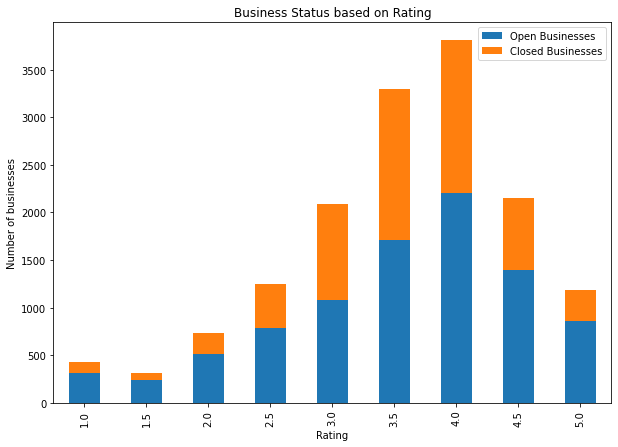

In [ ]:
ax = pd.concat([open['is_closed'], closed['is_closed']], axis = 1).\
              plot(title = 'Business Status based on Rating', kind = 'bar', stacked = True, figsize = (10, 7))
_ = ax.set_xlabel('Rating')
_ = ax.set_ylabel('Number of businesses')
_ = ax.legend(['Open Businesses', 'Closed Businesses'])

# Clustering

# Stripping the coordinates into longitudes and lattitudes

In [ ]:
#latitude, longitude=
coordinates=list(df['coordinates'])
latitude=[]
longitude=[]
for i in range(len(coordinates)):
    string=str(coordinates[i])
    start=string.index(':') + 2
    end=string.index(',')
    latitude.append(float(string[start:end]))

    string=string[end:]
    start=string.index(':') + 2
    end=string.index('}')
    longitude.append(float(string[start:end]))

Appending latitude and longitude data to the dataframe

In [ ]:
df['latitude']=latitude
df['longitude']=longitude

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import seaborn as sns; sns.set()
import csv

In [ ]:
# Dataframe with the Coordinates,Longitude and Latitude data to be used for clustering
X=df.loc[:,['coordinates','latitude','longitude']]  

# The value of n which is the number of clusters can be changed below, for our analysis we have divided the area into 20 clusters

In [ ]:
n=20

Applying KMeans clustering

In [ ]:
kmeans = KMeans(n_clusters = n, init ='k-means++')
kmeans.fit(X[X.columns[1:3]]) # Compute k-means clustering.
X['cluster_label'] = kmeans.fit_predict(X[X.columns[1:3]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(X[X.columns[1:3]]) # Labels of each point

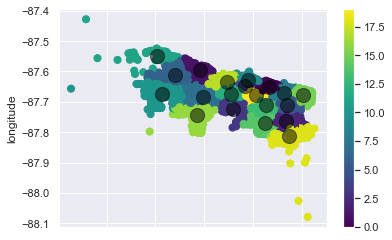

In [ ]:
X.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

In [ ]:
df['cluster_label']=list(X['cluster_label'])       #adding the cluster label column to the main data frame

# Creating a new dataframe df_cluster which will store store cluster data

In [ ]:
df_cluster=pd.DataFrame(range(n),columns=['Cluster_label'])            #n is the number of clusters

# Adding average rating to df_cluster dataframe 

In [ ]:
# adding average rating of each cluster to the df_cluster dataframe
average_rating=[]
for i in range(n):
    rating_list=list(df[df.cluster_label==i]['rating'])
    average_rating.append( sum(rating_list)/(len(rating_list)) )
df_cluster['Average_rating']=average_rating
    

# Analysing the Risk column of the dataframe

In [ ]:
set(df['Risk'])

{'All', 'Risk 1 (High)', 'Risk 2 (Medium)', 'Risk 3 (Low)', nan}

In [ ]:
#for finding the mode of the Risk column in the dataframe
df.groupby('Risk')["Name"].count()

Risk
All                    5
Risk 1 (High)      10107
Risk 2 (Medium)     3064
Risk 3 (Low)        2082
Name: Name, dtype: int64

Replacing nan with the mode which is Risk 1 and All with the highest risk which is also Risk 1

In [ ]:
df['Risk'] = df['Risk'].fillna('Risk 1 (High)')
df['Risk']=df['Risk'].replace('All','Risk 1 (High)')

# Finding the average risk factor by cluster

In [ ]:
# adding average risk factor of each cluster to the df_cluster dataframe
average_risk=[]
for i in range(n):
    risk_list=list(df[df.cluster_label==i]['Risk'])
    for j in range(len(risk_list)):
        if(risk_list[j]=='Risk 1 (High)'):
            risk_list[j]=1
        elif(risk_list[j]=='Risk 2 (Medium)'):
            risk_list[j]=2
        else:
            risk_list[j]=3
        
    average_risk.append( sum(risk_list)/(len(risk_list)) )
df_cluster['Average_risk']=average_risk
    

# Adding cluster size to the df_cluster dataframe

In [ ]:
df_cluster['Cluster_size']=list(df.groupby('cluster_label')['Name'].count())

In [ ]:
df_cluster

,Cluster_label,Average_rating,Average_risk,Cluster_size
0,0,3.676640,1.463751,1738
1,1,3.281465,1.533181,437
2,2,3.577511,1.484716,458
3,3,3.357383,1.533557,298
4,4,3.625534,1.351496,936
5,5,3.686977,1.485066,837
6,6,3.040573,1.587112,419
7,7,3.279787,1.523404,470
8,8,3.733821,1.540832,1298
9,9,3.481116,1.394880,2383


# Using google API for fetching the neighbourhoods of the restaurants

In [ ]:
#from googlemaps import Client as GoogleMaps
#API key commented out for security reasons
#gmaps = GoogleMaps('####')   

In [ ]:
### Commented so that dont hit api again

#df['Neighbourhood']=''
# for i, row in df.iterrows():
#     location = gmaps.reverse_geocode((df.at[i,'latitude'],df.at[i,'longitude']))
#     if (len(location) == 0):
#         df.at[i,'Neighborhood']=''
#     else:
#         for d in location[0]['address_components']:
#             if(d['types'][0]=='neighborhood'):
#                 add=d['long_name']
#         df.at[i,'Neighborhood']=add

# df.head()
# df[['Neighborhood']].to_csv('neighborhoods.csv')

In [ ]:
# the neighborhoods data was stored in the csv after running the above code once 
# so that we won't have to hit the api again for the data
df_neighborhood=pd.read_csv('neighborhoods.csv')

In [ ]:
#adding the neighborhood data to the main dataframe
df['neighborhood']=df_neighborhood['Neighborhood']

# Merging categories data of all the restaurants in a cluster and adding the merged data to the cluster dataframe

In [ ]:
cluster_category_list=[]
for i in range(n):           #for n clusters
    category_merged=[]
    cat_list=list(df[df.cluster_label==i]['categories'])
    for rest_list in cat_list:
        for sub_dict in rest_list:
            category_merged.append(sub_dict['title'].lower())
    cluster_category_list.append(category_merged)
    

In [ ]:
df_cluster['Category_merged']=cluster_category_list

# Finding the neighborhoods for each cluster and adding it to the cluster dataframe

In [ ]:
from statistics import mode
df_cluster['Neighborhood']=''
for i in range(n):
    df_cluster.at[i,'Neighborhood']=mode(list(df[df.cluster_label==i]['neighborhood']))

# Using folium to plot clusters on map

In [ ]:
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

In [ ]:
#for printing the legend for the pollium plot
def colored(r, g, b, text):
    return "\033[38;2;{};{};{}m{} \033[38;2;255;255;255m".format(r, g, b, text)
#print(colored(255, 0, 0, 'Hello, World'))
from PIL import ImageColor
#ImageColor.getcolor("#23a9dd", "RGB")

In [ ]:
# Chicago latitude and longitude
Chilatitude=41.8781136
Chilongitude=-87.6297982

In [ ]:
map_clusters = folium.Map(location=[Chilatitude, Chilongitude], zoom_start=11)

 # set color scheme for the clusters
x = np.arange(n)
ys = [i + x + (i*x)**2 for i in range(n)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# # add markers to the map
# markers_colors = []
for name,neighborhood,lat, lon, cluster in zip(df['Name'],df['neighborhood'],df['latitude'], df['longitude'], df['cluster_label']):
    #label = folium.Popup(' Cluster'+':'+str(cluster)+'\n'+'Restaurant name:'+name+'\n'+'Neighborhood:'+neighborhood, parse_html=True)
    label1 = ' Cluster:'+str(cluster)
    label2 = ' Restaurant Name:'+name
    label3 = ' Neighborhood:'+neighborhood
    folium.CircleMarker(
        [lat, lon],
        radius=0.5,
        popup="{} <br> {} <br> {}".format(label1,label2,label3),
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
display(map_clusters)
#for displaying the legend
for i in range(n):
        cluster_color=rainbow[i-1]  # color in hex code
        cluster_RGB=ImageColor.getcolor(cluster_color,"RGB")   #
        print(colored(cluster_RGB[0],cluster_RGB[1],cluster_RGB[2],str(i)+':'+df_cluster['Neighborhood'][i]))

0:Lake View East 
1:Hyde Park 
2:Portage Park 
3:South Lawndale 
4:West Loop 
5:Albany Park 
6:Greater Grand Crossing 
7:Brighton Park 
8:North Center 
9:Chicago Loop 
10:Beverly 
11:East Side 
12:Lower West Side 
13:Logan Square 
14:Belmont Cragin 
15:Rogers Park 
16:Garfield Ridge 
17:Armour Square 
18:Norwood Park 
19:West Town 


# Function that will take the cluster number as input and plot the corresponding cluster on map

In [ ]:
def plot_cluster(cluster_list):
    Chilatitude=41.8781136
    Chilongitude=-87.6297982
    map_clusters = folium.Map(location=[Chilatitude, Chilongitude], zoom_start=11)
  
    #for name,lat, lon, cluster in zip(df['Name'],df['latitude'], df['longitude'], df['cluster_label']):
    for name,neighborhood,lat, lon, cluster in zip(df['Name'],df['neighborhood'],df['latitude'], df['longitude'], df['cluster_label']):
        if cluster in cluster_list:
            #label = folium.Popup(' Cluster ' + str(cluster), parse_html=True)
            #label = folium.Popup(' Cluster ' + str(cluster) + ':' + name+'(' + neighborhood +')', parse_html=True)
            #label = folium.Popup(' Cluster'+':'+str(cluster)+'\n'+'Restaurant name:'+name+'\n'+'Neighborhood:'+neighborhood, parse_html=True)
            label1 = ' Cluster:'+str(cluster)
            label2 = ' Restaurant Name:'+name
            label3 = ' Neighborhood:'+neighborhood
            folium.CircleMarker(
                [lat, lon],
                radius=0.5,
                popup="{} <br> {} <br> {}".format(label1,label2,label3),
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.7).add_to(map_clusters)
    
        
    display(map_clusters)
    for i in cluster_list:
        cluster_color=rainbow[i-1]  # color in hex code
        cluster_RGB=ImageColor.getcolor(cluster_color,"RGB")   #
        print(colored(cluster_RGB[0],cluster_RGB[1],cluster_RGB[2],str(i)+':'+df_cluster['Neighborhood'][i]))

The code below will find out the cluster with the most number of matches with the user_choice and will suggest that cluster to the user.

Enter your choice or category of food:Indian
The cluster with maximum number of matches is: 15:Rogers Park


15:Rogers Park 


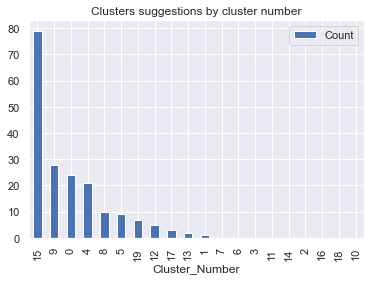

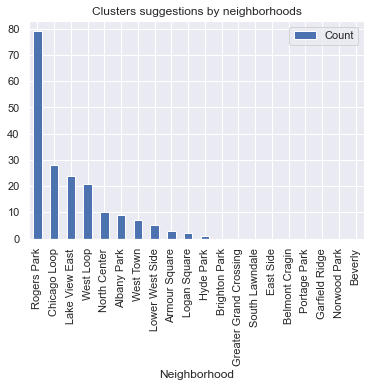

In [ ]:
user_choice=input('Enter your choice or category of food:')


user_choice=user_choice.lower()

count_list=[]              #list will store the count of mathes for each cluster
             
for i in range(n):        #iterating through every cluster
    count=0               #count is the number of matches of categories with the user_choice
    
    for cat in df_cluster['Category_merged'][i]:
        if user_choice in cat:
            count=count+1
    
    count_list.append(count)

max_value=max(count_list)

if max_value==0:
    print("No cluster found with the given category of food")
else:
    #creating a new dataframe that stores count of the matches and cluster number
    df_count=pd.DataFrame(count_list,columns=['Count'])
    df_count['Cluster_Number']=range(n)
    df_count['Neighborhood']=df_cluster['Neighborhood']
    max_count=max (count_list)
    max_cluster_list=[]
    if count_list.count(max_count)!=1:  #more than one occurences of maximum value
        print("Following are the clusters which have the maximum matches:")
        for i in range(n):
            if count_list[i]==max_count:
                print(i,df_count['Neighborhood'][i])
                max_cluster_list.append(i)
    else:                                #when number of clusters with matches is 1
        max_index_cluster=count_list.index(max_value)
        print("The cluster with maximum number of matches is:",max_index_cluster,end=':')
        print(df_count['Neighborhood'][max_index_cluster])
        
        max_cluster_list.append(max_index_cluster)
        
    df_count.sort_values('Count',ascending=False).plot(x='Cluster_Number',y='Count', \
                                       kind='bar',title='Clusters suggestions by cluster number')
    df_count.sort_values('Count',ascending=False).plot(x='Neighborhood',y='Count', \
                                       kind='bar',title='Clusters suggestions by neighborhoods')
    plot_cluster(max_cluster_list)

The code below will find out the cluster(s) with the least number of matches with the new buisness owner choice of food type therefore indicating less competition and more chances of success for that new buisness owner

Enter your choice or category of food:Chinese
The cluster with minimum number of matches is: 11:East Side


11:East Side 


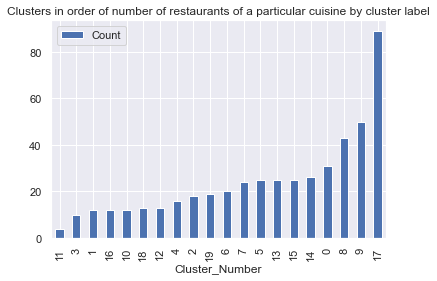

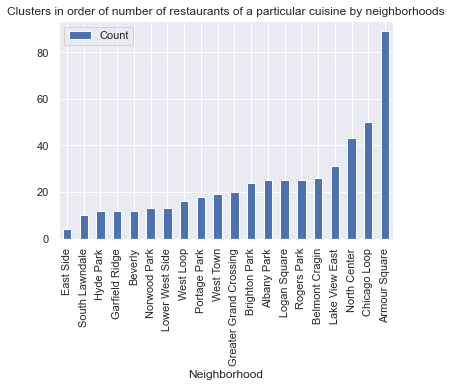

In [ ]:
user_choice=input('Enter your choice or category of food:')

user_choice=user_choice.lower()

count_list=[]              #list will store the count of mathes for each cluster
             
for i in range(n):        #iterating through every cluster
    count=0               #count is the number of matches of categories with the user_choice
    
    for cat in df_cluster['Category_merged'][i]:
        if user_choice in cat:
            count=count+1
    
    count_list.append(count)

min_value=min(count_list)

if max(count_list)==0:
    print("No cluster found with the given category of food")
else:
    #creating a new dataframe that stores count of the matches and cluster number
    df_count=pd.DataFrame(count_list,columns=['Count'])
    df_count['Cluster_Number']=range(n)
    df_count['Neighborhood']=df_cluster['Neighborhood']
    
    min_count=min (count_list)
    min_cluster_list=[]
    if count_list.count(min_count)!=1:  #more than one occurences of minimum value
        print("Following are the clusters which had the minimum matches:")
        for i in range(n):
            if count_list[i]==min_count:
                print(i,end=':')
                print(df_count['Neighborhood'][i])
                min_cluster_list.append(i)
        #plot_cluster(min_cluster_list)
        
    else:                                #when number of clusters with matches is 1
        print("The cluster with minimum number of matches is:",count_list.index(min_value),end=':')
        print(df_count['Neighborhood'][count_list.index(min_value)])
        min_cluster_list.append(count_list.index(min_value))
        
    df_count.sort_values('Count').plot(x='Cluster_Number',y='Count', \
                                       kind='bar',title='Clusters in order of number of restaurants of a particular cuisine by cluster label')
    df_count.sort_values('Count').plot(x='Neighborhood',y='Count', \
                                       kind='bar',title='Clusters in order of number of restaurants of a particular cuisine by neighborhoods')
    plot_cluster(min_cluster_list) 

# Analyzing the clusters based on the scope of opportunity in each cluster

Business Opportunity Ranking

(i) Inversely proportional to the cluster size (greater the size more dense will be the cluster and thus more will be the competition).

(ii) Inversely proportional to the cluster average rating (greater the rating lesser will be the chance of new business to succeed among the successful competition).

(iii) Inversely proportional to the risk rating of a cluster (lesser the average risk rating, better is the inspection record of that cluster, more will be the competition from good inspection records restaurants). 
We define Business Opportunity Ranking for a particular cluster i as:

( (AverageRating(i)X AverageRisk(i)XClusterSize(i))/(TotalAverageRatingXTotalAverageRiskXTotalAverageSize) ) X 100 X 100 X 100

Smaller the value of Business Opportunity Ranking for a cluster, more will be the scope of success of new business in that area!

The best cluster to open restaurant is 11:East Side


11:East Side 


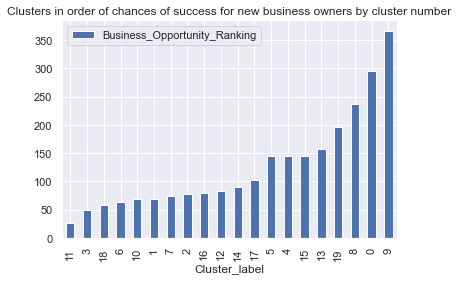

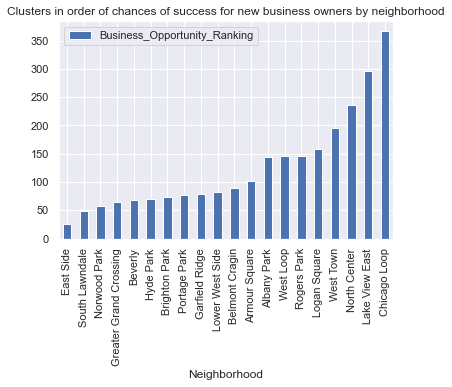

In [ ]:
total_avg_rating= sum(list(df_cluster['Average_rating']))
total_avg_risk=sum(list(df_cluster['Average_risk']))
total_cluster_size=sum(list(df_cluster['Cluster_size']))

df_cluster['Business_Opportunity_Ranking'] = (df_cluster['Average_rating']/total_avg_rating) * \
                                             (df_cluster['Average_risk']/total_avg_risk) * \
                                             (df_cluster['Cluster_size']/total_cluster_size)

df_cluster['Business_Opportunity_Ranking']=df_cluster['Business_Opportunity_Ranking']*100*100*100

list_opportunity=list(df_cluster['Business_Opportunity_Ranking'])
print("The best cluster to open restaurant is",list_opportunity.index(min(list_opportunity)),end=':')
print(df_cluster['Neighborhood'][list_opportunity.index(min(list_opportunity))])

df_cluster.sort_values('Business_Opportunity_Ranking').plot(x='Cluster_label',y='Business_Opportunity_Ranking', \
                                       kind='bar',title='Clusters in order of chances of success for new business owners by cluster number')
df_cluster.sort_values('Business_Opportunity_Ranking').plot(x='Neighborhood',y='Business_Opportunity_Ranking', \
                                       kind='bar',title='Clusters in order of chances of success for new business owners by neighborhood')
plot_cluster([list_opportunity.index(min(list_opportunity))]) 

# Finding the cluster with the best average rating

Cluster 19:West Town has the best average rating


19:West Town 


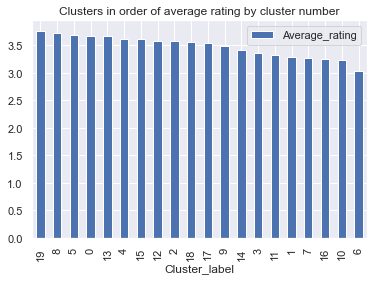

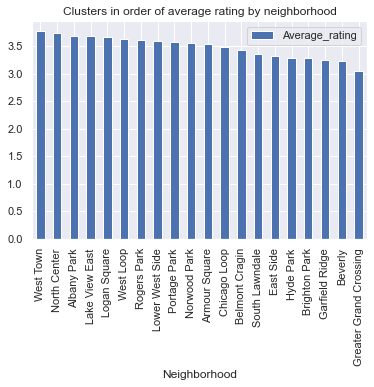

In [ ]:
rating_list=list(df_cluster['Average_rating'])
print("Cluster",rating_list.index(max(rating_list)),end=':')
print(df_cluster['Neighborhood'][rating_list.index(max(rating_list))],"has the best average rating")
df_cluster.sort_values('Average_rating',ascending=False).plot(x='Cluster_label',y='Average_rating', \
                                       kind='bar',title='Clusters in order of average rating by cluster number')
df_cluster.sort_values('Average_rating',ascending=False).plot(x='Neighborhood',y='Average_rating', \
                                       kind='bar',title='Clusters in order of average rating by neighborhood')
plot_cluster([rating_list.index(max(rating_list))])  

# Finding the cluster that has the worst average inspection risk record

Cluster 4:West Loop has the worst average risk


4:West Loop 


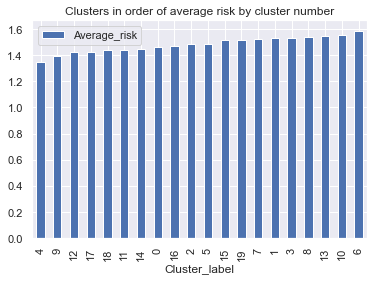

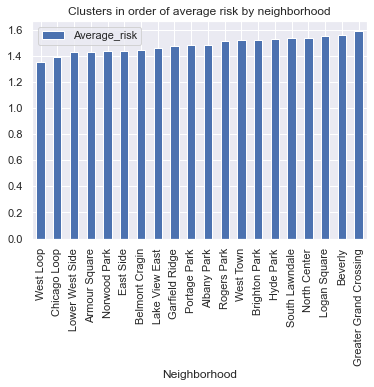

In [ ]:
risk_list=list(df_cluster['Average_risk'])
print("Cluster",risk_list.index(min(risk_list)),end=':')
print(df_cluster['Neighborhood'][risk_list.index(min(risk_list))],"has the worst average risk")
      
df_cluster.sort_values('Average_risk').plot(x='Cluster_label',y='Average_risk', \
                                       kind='bar',title='Clusters in order of average risk by cluster number')
df_cluster.sort_values('Average_risk').plot(x='Neighborhood',y='Average_risk', \
                                       kind='bar',title='Clusters in order of average risk by neighborhood')
plot_cluster([risk_list.index(min(risk_list))]) 

# Adding Failed business count per cluster and Business_failure_rate data to the cluster dataframe

In [ ]:
df_cluster['Failed_businesses'] = df[df['is_closed'] == True].groupby('cluster_label')['is_closed'].count()
df_cluster['Business_failure_rate'] = df_cluster['Failed_businesses'] / df_cluster['Cluster_size']

# Finding the cluster with the highest business failure rate

Cluster 0:Lake View East has the highest Business failure rate


0:Lake View East 


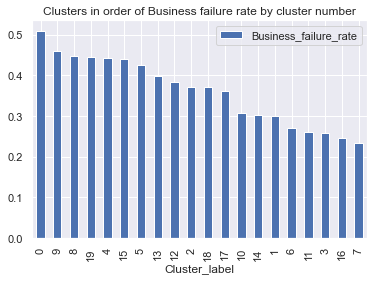

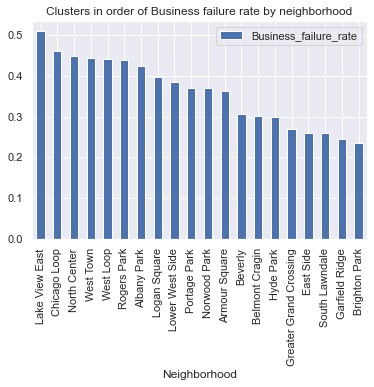

In [ ]:
failure_rate_list=list(df_cluster['Business_failure_rate'])
print("Cluster",failure_rate_list.index(max(failure_rate_list)),end=':')
print(df_cluster['Neighborhood'][failure_rate_list.index(max(failure_rate_list))],"has the highest Business failure rate")

df_cluster.sort_values('Business_failure_rate',ascending=False).plot(x='Cluster_label',y='Business_failure_rate', \
                                       kind='bar',title='Clusters in order of Business failure rate by cluster number')
df_cluster.sort_values('Business_failure_rate',ascending=False).plot(x='Neighborhood',y='Business_failure_rate', \
                                       kind='bar',title='Clusters in order of Business failure rate by neighborhood')
plot_cluster([failure_rate_list.index(max(failure_rate_list))]) 